Wordcloud 

In [39]:
import pandas as pd
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
import string
from nltk.stem import WordNetLemmatizer
from tqdm import tqdm
data_path = "\\Users\\Ilina Kirovska\\Desktop\\pri_project\\PRI-project-main\\datasets\\04_Universities_with_city_wikipedia_page.csv"
df = pd.read_csv(data_path)
#wiki_texts = df["Wikipedia Text"].tolist()
wiki_texts = df["City wikipedia text"].tolist()
text = " ".join(wiki_texts)

[nltk_data] Downloading package wordnet to C:\Users\Ilina
[nltk_data]     Kirovska\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Ilina
[nltk_data]     Kirovska\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [40]:
#preprocessing data

#lowercase
text = text.lower()
#remove punctuation
text = text.translate(str.maketrans('', '', string.punctuation))
#tokenize
tokens = nltk.word_tokenize(text)
#remove numbers and stopwords
tokens = [word for word in tqdm(tokens) if word.isalpha()]
tokens = [word for word in tqdm(tokens) if word not in nltk.corpus.stopwords.words('english')]
#lemmatize
wnl = WordNetLemmatizer()
tokens = [wnl.lemmatize(word) for word in tqdm(tokens)]
print(tokens)

100%|██████████| 2129275/2129275 [00:30<00:00, 70628.91it/s] 


['cambridge', 'university', 'city', 'county', 'town', 'cambridgeshire', 'england', 'located', 'river', 'cam', 'approximately', 'north', 'london', 'united', 'kingdom', 'census', 'population', 'cambridge', 'cambridge', 'became', 'important', 'trading', 'centre', 'roman', 'viking', 'age', 'archaeological', 'evidence', 'settlement', 'area', 'early', 'bronze', 'age', 'first', 'town', 'charter', 'granted', 'century', 'although', 'modern', 'city', 'status', 'officially', 'conferred', 'city', 'famous', 'home', 'university', 'cambridge', 'founded', 'consistently', 'rank', 'among', 'best', 'university', 'world', 'building', 'university', 'include', 'king', 'college', 'chapel', 'cavendish', 'laboratory', 'cambridge', 'university', 'library', 'one', 'largest', 'legal', 'deposit', 'library', 'world', 'city', 'skyline', 'dominated', 'several', 'college', 'building', 'along', 'spire', 'lady', 'english', 'martyr', 'church', 'chimney', 'addenbrookes', 'hospital', 'anglia', 'ruskin', 'university', 'evol

In [41]:
#count word frequencies
from collections import Counter
token_frequency = Counter(tokens)
print(token_frequency)

Counter({'city': 41723, 'also': 10365, 'one': 8811, 'century': 8583, 'area': 8462, 'moscow': 8219, 'university': 8072, 'world': 8037, 'centre': 7641, 'first': 7233, 'london': 6846, 'population': 6614, 'de': 6444, 'museum': 6384, 'town': 6213, 'year': 6107, 'building': 6096, 'new': 6052, 'largest': 5431, 'since': 5430, 'many': 5283, 'station': 5165, 'part': 5063, 'church': 5006, 'park': 4956, 'school': 4819, 'national': 4755, 'built': 4729, 'art': 4719, 'international': 4553, 'time': 4409, 'two': 4264, 'including': 4241, 'district': 4219, 'born': 4156, 'war': 4096, 'became': 4030, 'people': 3980, 'capital': 3940, 'street': 3929, 'located': 3928, 'known': 3771, 'line': 3661, 'russian': 3649, 'house': 3640, 'europe': 3640, 'home': 3625, 'around': 3624, 'main': 3621, 'local': 3599, 'state': 3580, 'river': 3574, 'place': 3554, 'public': 3542, 'service': 3483, 'name': 3455, 'well': 3398, 'major': 3360, 'number': 3277, 'german': 3241, 'central': 3233, 'history': 3209, 'railway': 3200, 'europe

{'city': 41723, 'also': 10365, 'one': 8811, 'century': 8583, 'area': 8462, 'moscow': 8219, 'university': 8072, 'world': 8037, 'centre': 7641, 'first': 7233, 'london': 6846, 'population': 6614, 'de': 6444, 'museum': 6384, 'town': 6213, 'year': 6107, 'building': 6096, 'new': 6052, 'largest': 5431, 'since': 5430, 'many': 5283, 'station': 5165, 'part': 5063, 'church': 5006, 'park': 4956, 'school': 4819, 'national': 4755, 'built': 4729, 'art': 4719, 'international': 4553, 'time': 4409, 'two': 4264, 'including': 4241, 'district': 4219, 'born': 4156, 'war': 4096, 'became': 4030, 'people': 3980, 'capital': 3940, 'street': 3929, 'located': 3928, 'known': 3771, 'line': 3661, 'russian': 3649, 'house': 3640, 'europe': 3640, 'home': 3625, 'around': 3624, 'main': 3621, 'local': 3599, 'state': 3580, 'river': 3574, 'place': 3554, 'public': 3542, 'service': 3483, 'name': 3455, 'well': 3398, 'major': 3360, 'number': 3277, 'german': 3241, 'central': 3233, 'history': 3209, 'railway': 3200, 'european': 314

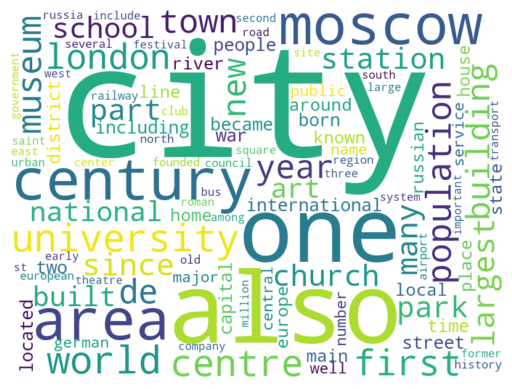

In [42]:
#create word cloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt

most_common_words = token_frequency.most_common(100)
wordcloud_dict = {key: value for key, value in most_common_words}
print(wordcloud_dict)

wordcloud = WordCloud(width = 800, height = 600, background_color = 'white').generate_from_frequencies(wordcloud_dict)
wordcloud.to_file("\\Users\\Ilina Kirovska\\Desktop\\pri_project\\PRI-project-main\\visualization\\images\\wordcloud_city.png")
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Score distribution

<Axes: ylabel='Frequency'>

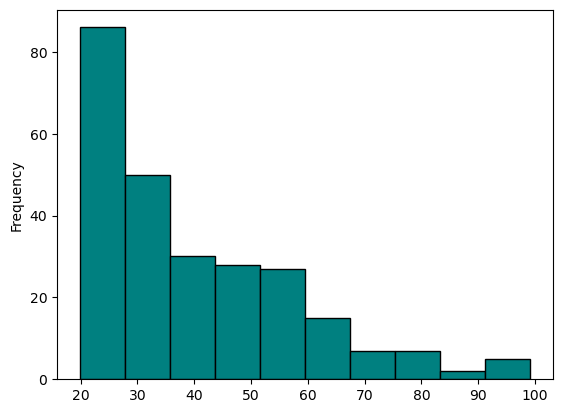

In [44]:
import pandas as pd
df = pd.read_csv("\\Users\\Ilina Kirovska\\Desktop\\pri_project\\PRI-project-main\\datasets\\01_Universities_ranking_filtered.csv")
filtered_values = df['Overall SCORE'][df['Overall SCORE'] != '-']
filtered_values = pd.to_numeric(filtered_values, errors='coerce')
filtered_values.plot(kind='hist', edgecolor='black', color='teal')